<a href="https://www.kaggle.com/code/ahmednasser1601/face-crop?scriptVersionId=147266259" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
pip install -U git+https://github.com/luca-medeiros/lang-segment-anything.git

  Cloning https://github.com/luca-medeiros/lang-segment-anything.git to /tmp/pip-req-build-b_as1nft
  Running command git clone --filter=blob:none --quiet https://github.com/luca-medeiros/lang-segment-anything.git /tmp/pip-req-build-b_as1nft
  Resolved https://github.com/luca-medeiros/lang-segment-anything.git to commit e6b339b84b22e8dbf05c9d51a7b232a505fe5a16
  Installing build dependencies ... - \ | done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Cloning https://github.com/IDEA-Research/GroundingDINO.git to /tmp/pip-install-q41qgmzs/groundingdino_fbefab8e77214eaf87bad1421514b79d
  Running command git clone --filter=blob:none --quiet https://github.com/IDEA-Research/GroundingDINO.git /tmp/pip-install-q41qgmzs/groundingdino_fbefab8e77214eaf87bad1421514b79d
  Resolved https://github.com/IDEA-Research/GroundingDINO.git to commit 60d796825e1266e56f7e4e9e00e88de662b67bd3
  Preparing metadata (setup.py) ... - done
  Cloning https:

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from lang_sam import LangSAM

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
model = LangSAM()

input_folder = '/kaggle/input/segmentation'
output_folder = '/kaggle/working'

/opt/conda/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


Model loaded from /root/.cache/huggingface/hub/models--ShilongLiu--GroundingDINO/snapshots/a94c9b567a2a374598f05c584e96798a170c56fb/groundingdino_swinb_cogcoor.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


Downloading: "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth" to /root/.cache/torch/hub/checkpoints/sam_vit_h_4b8939.pth
100%|██████████| 2.39G/2.39G [00:11<00:00, 222MB/s]


In [4]:
def crop_bounding_boxes(image, boxes, padding=25):
    cropped_images = []

    for box in boxes:
        x_min, y_min, x_max, y_max = box
        x_min, y_min, x_max, y_max = int(x_min), int(y_min), int(x_max), int(y_max)  # Convert to integers

        # Add padding to the cropping region
        x_min = max(0, x_min - padding)
        y_min = max(0, y_min - padding - padding)
        x_max = min(image.shape[1], x_max + padding)
        y_max = min(image.shape[0], y_max + padding + padding + padding)

        cropped_image = image[y_min:y_max, x_min:x_max]
        cropped_images.append(cropped_image)

    return cropped_images

In [5]:
def save_cropped_images(cropped_images, output_folder, filename):
    for i, cropped_image in enumerate(cropped_images):
        output_filename = os.path.join(output_folder, f"{filename}_{i+1}.jpg")
        Image.fromarray(cropped_image).save(output_filename)

In [6]:
def display_cropped_images(cropped_images):
    num_crops = len(cropped_images)

    fig, axes = plt.subplots(1, num_crops, figsize=(15, 5))

    if num_crops == 1:
        axes.imshow(cropped_images[0])
        axes.axis('off')
    else:
        for i, cropped_image in enumerate(cropped_images):
            axes[i].imshow(cropped_image)
            axes[i].set_title(i+1)
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()

In [7]:
def Segment(model, img, img_title, output_folder):
    masks, boxes, phrases, logits = model.predict(img, "face and hair and head and cap and neck")

    if all(phrase in phrases for phrase in ["face"]):
        cropped_images = crop_bounding_boxes(np.array(img), boxes)
        save_cropped_images(cropped_images, output_folder, img_title)
        print('Image: ' + img_title)
        return cropped_images, phrases
    else:
        return None, ('\t' + img_title + ': Try Another Image')

/opt/conda/lib/python3.10/site-packages/transformers/modeling_utils.py:909: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


Image: 01.jpg


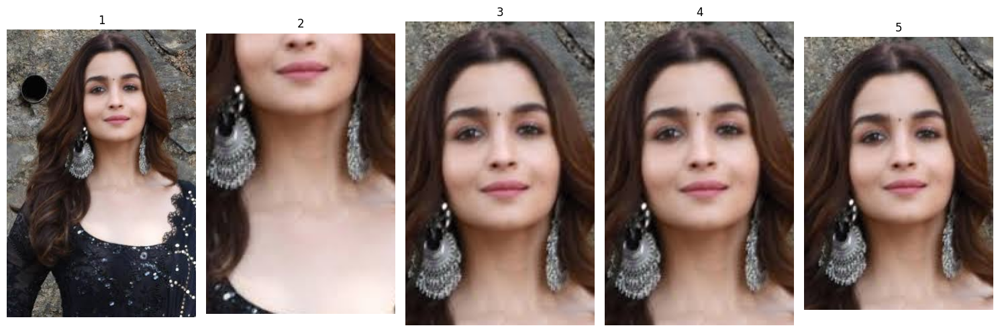

['hair', 'neck', 'face', 'head', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 02.jpg


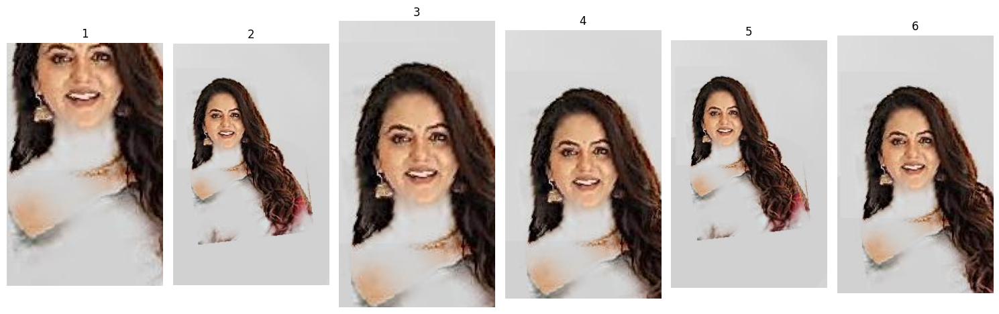

['neck', 'hair', 'face', 'head', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 03.jpg


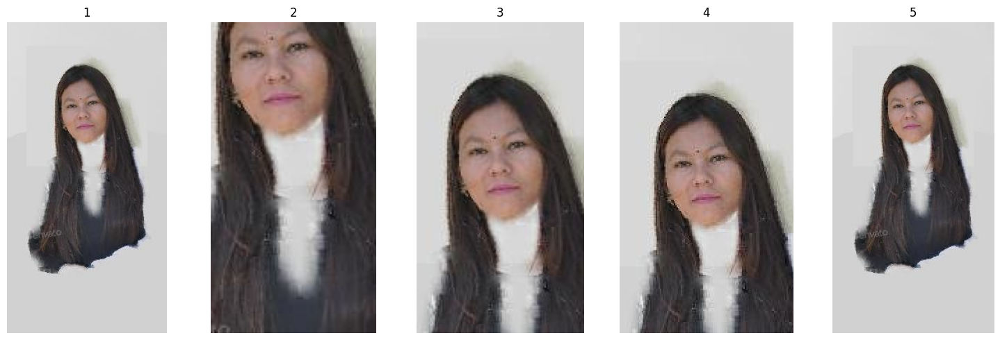

['hair', 'neck', 'face', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 04.jpg


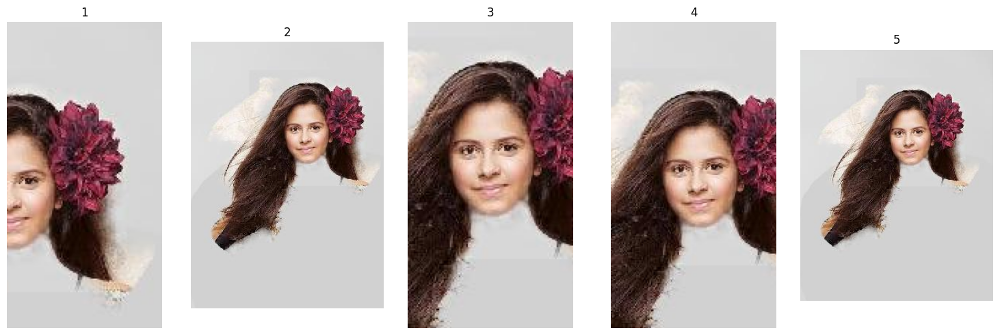

['cap', 'hair', 'face', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 05.jpg


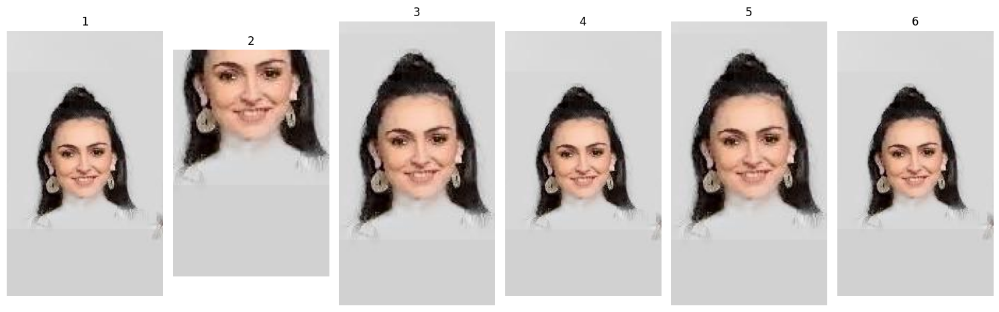

['hair', 'neck', 'face', 'head', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 06.jpg


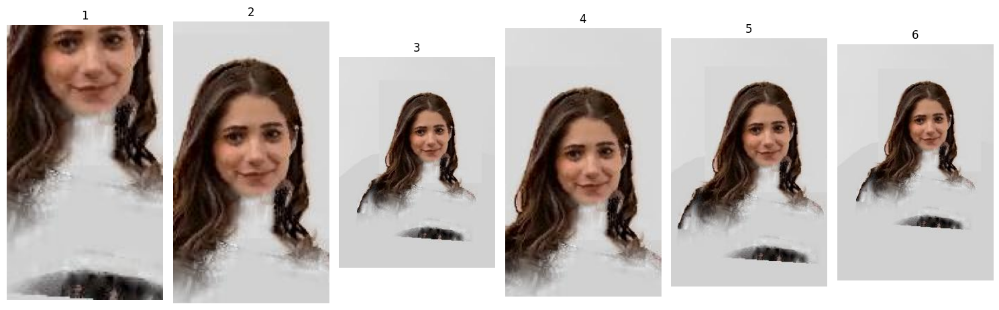

['neck', 'face', 'hair', 'head', 'hair', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 07.jpg


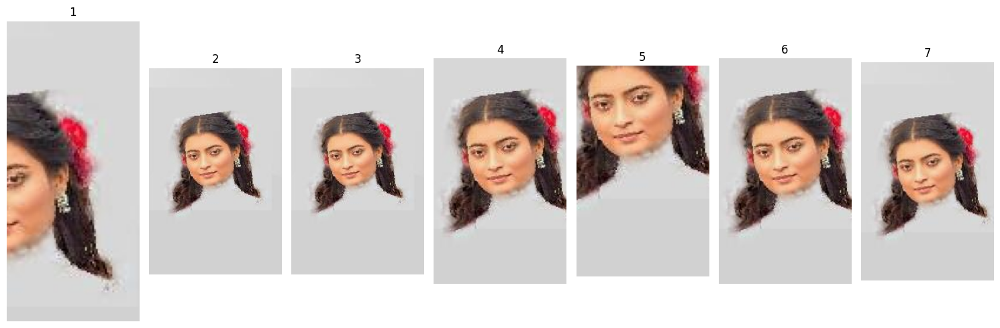

['cap', 'face', 'hair', 'face', 'neck', 'head', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 08.jpg


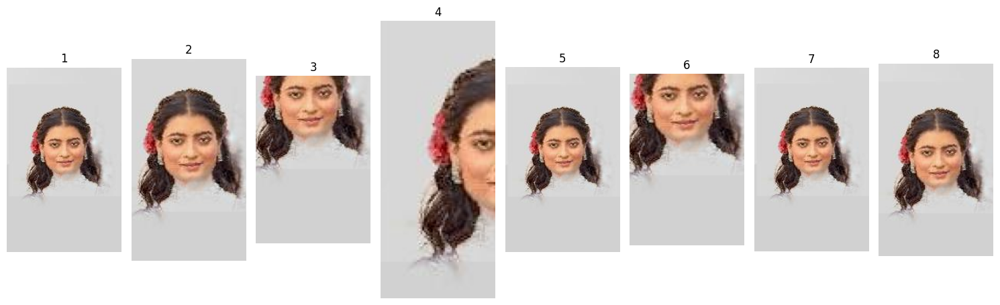

['face', 'face', 'neck', 'cap', 'hair', 'neck', 'head', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 09.jpg


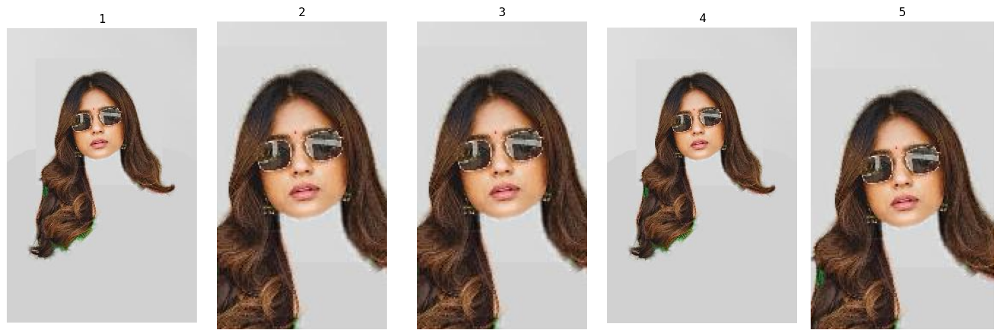

['hair', 'face', 'head', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 10.jpg


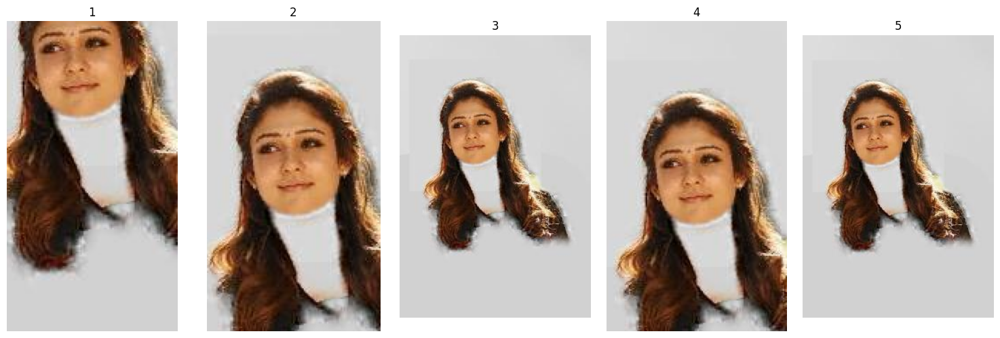

['neck', 'face', 'hair', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 11.jpg


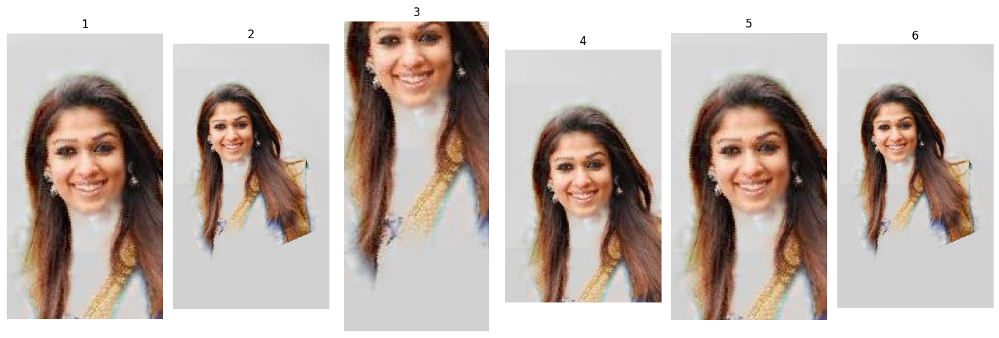

['face', 'hair', 'neck', 'head', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 12.jpg


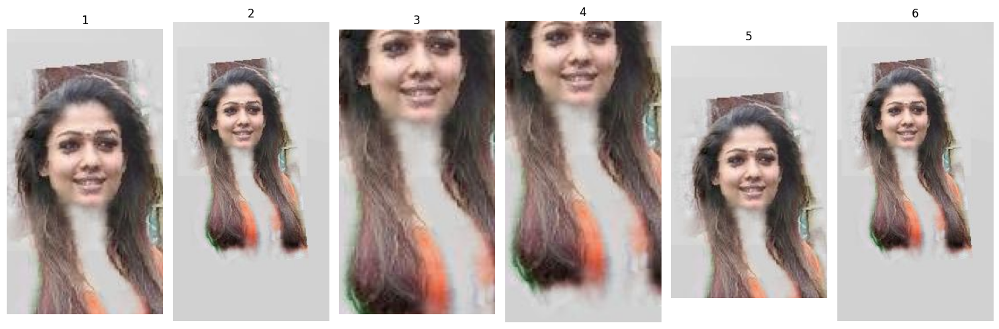

['face', 'hair', 'neck', 'neck', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 13.jpg


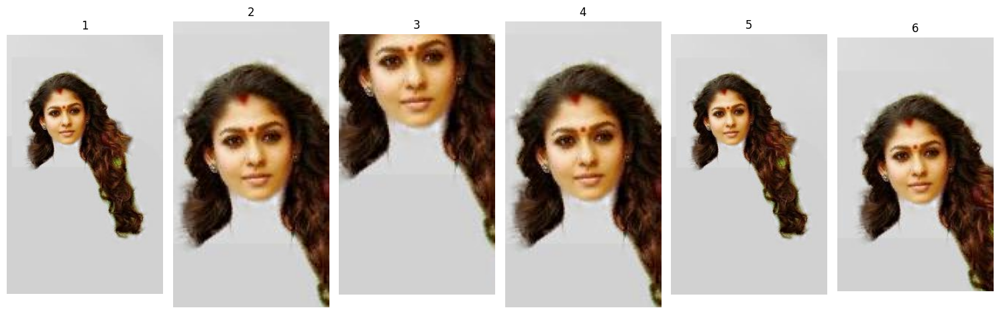

['hair', 'face', 'neck', 'head', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 14.jpg


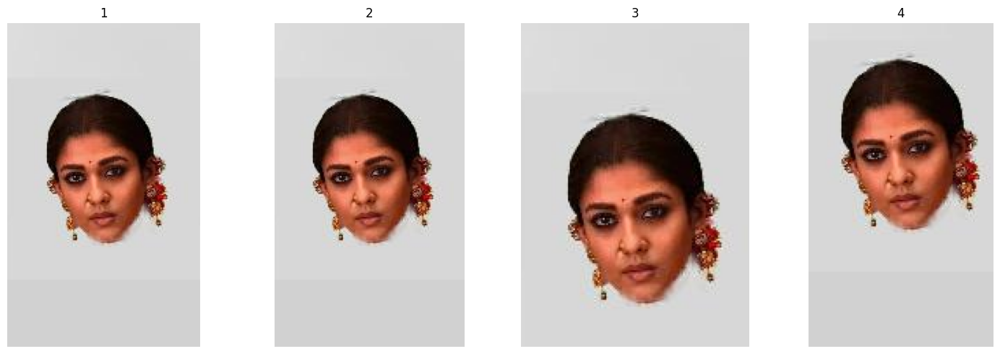

['face', 'head', 'hair', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 15.jpg


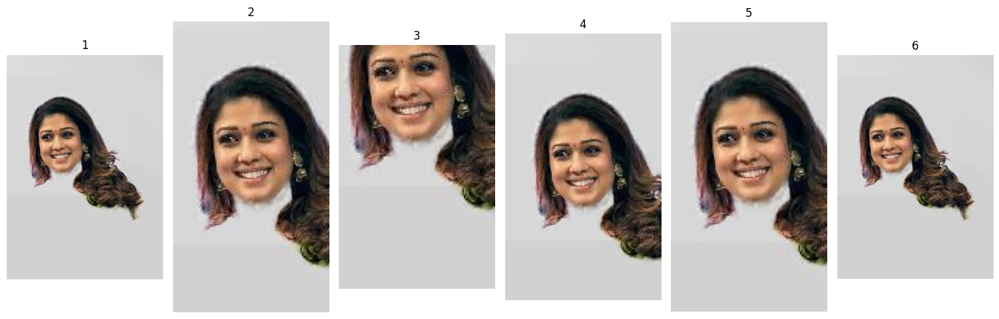

['hair', 'face', 'neck', 'head', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 16.jpg


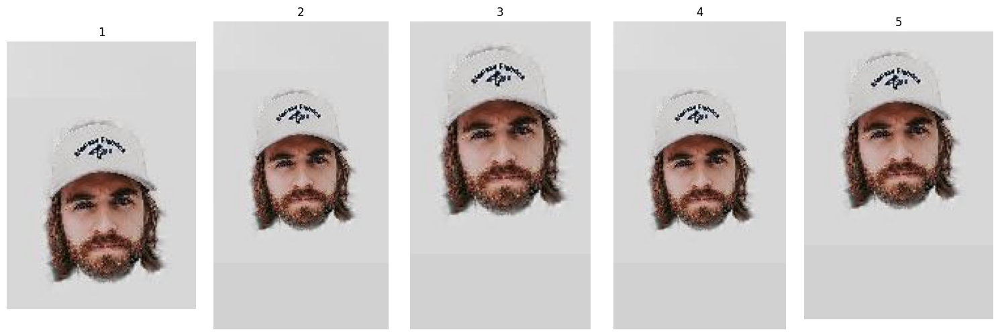

['cap', 'face', 'face', 'head', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 17.jpg


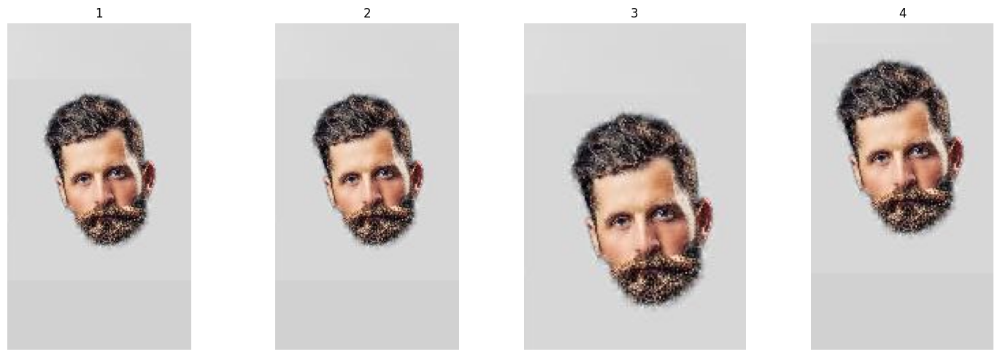

['face', 'head', 'hair', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 18.jpg


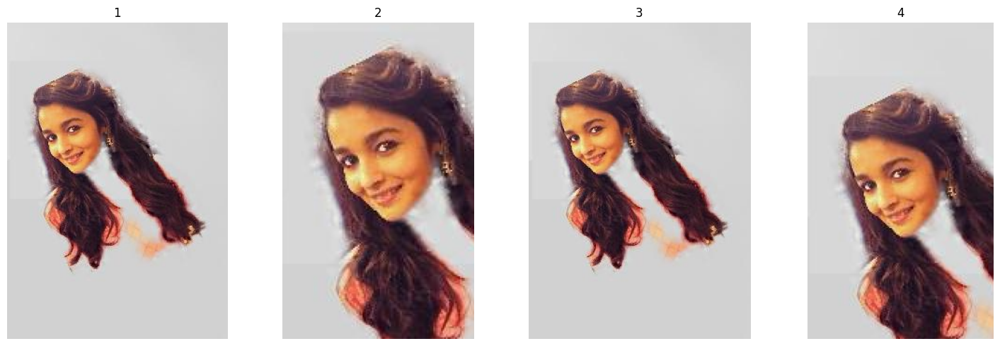

['hair', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 19.jpg


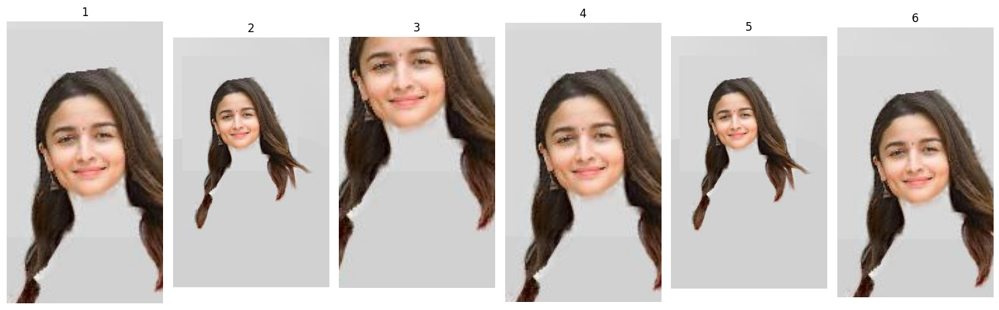

['face', 'hair', 'neck', 'head', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 20.jpg


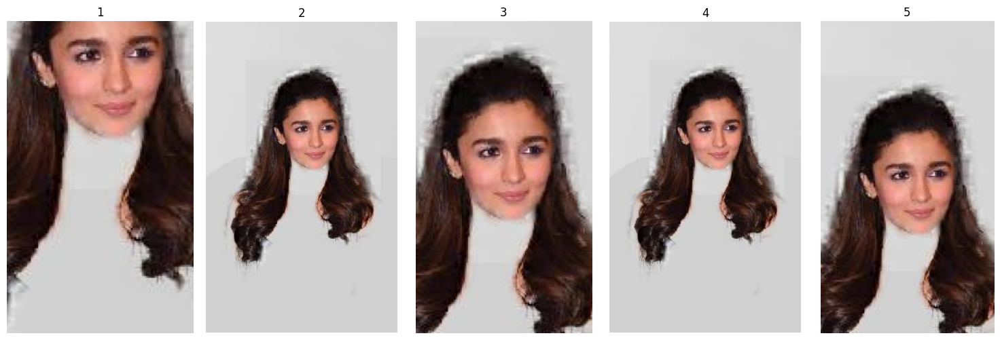

['neck', 'hair', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 21.jpg


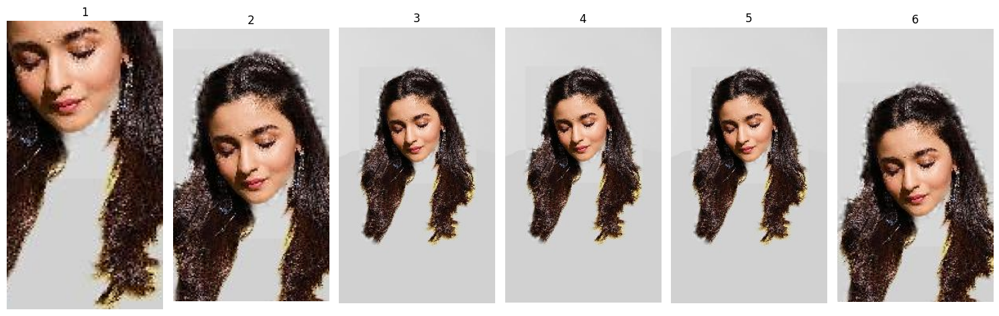

['neck', 'face', 'hair', 'head', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 22.jpg


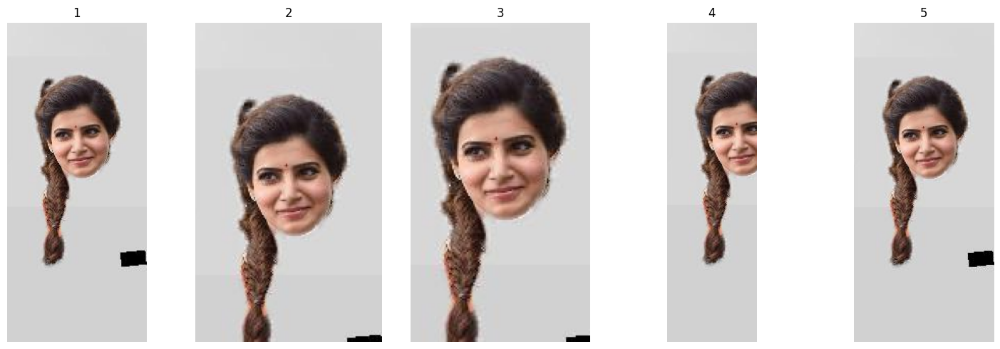

['hair', 'head', 'face', 'hair', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 23.jpg


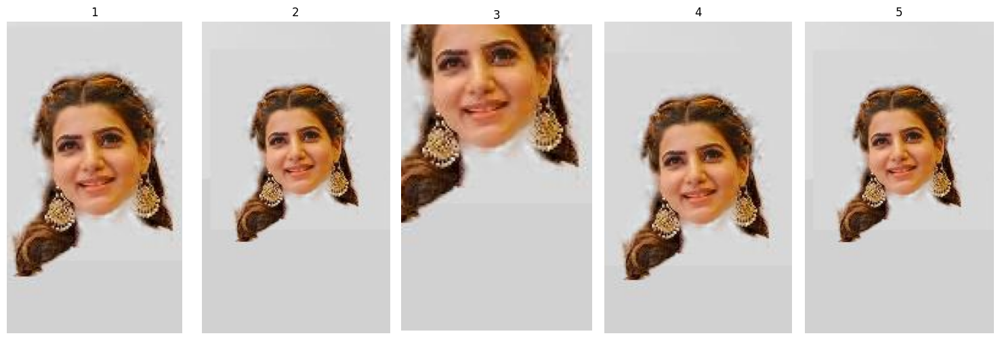

['face', 'hair', 'neck', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 24.jpg


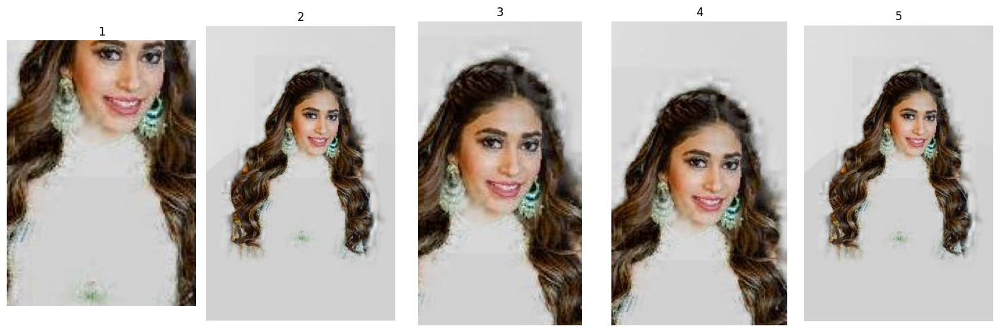

['neck', 'hair', 'face', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 25.jpg


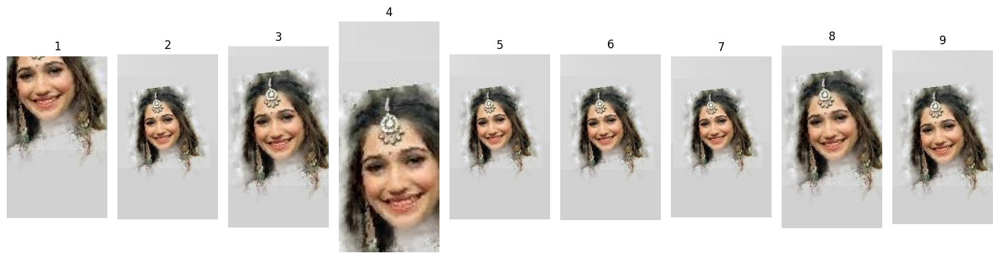

['neck', 'face', 'face', 'cap', 'hair', 'head', 'cap', 'head', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 26.jpg


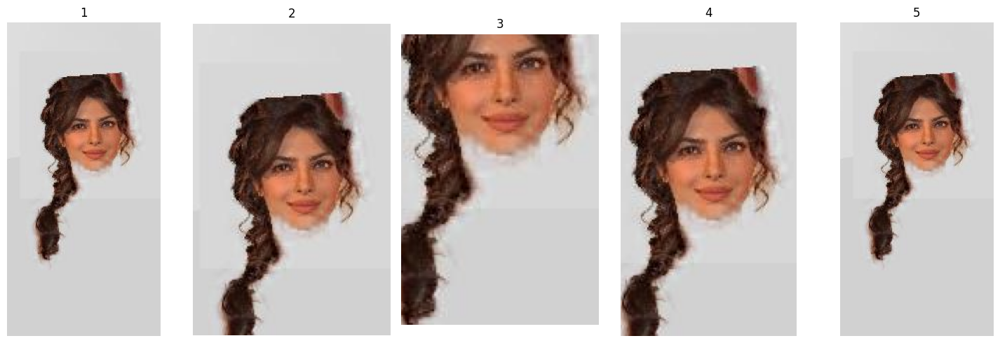

['hair', 'head', 'neck', 'face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 27.jpg


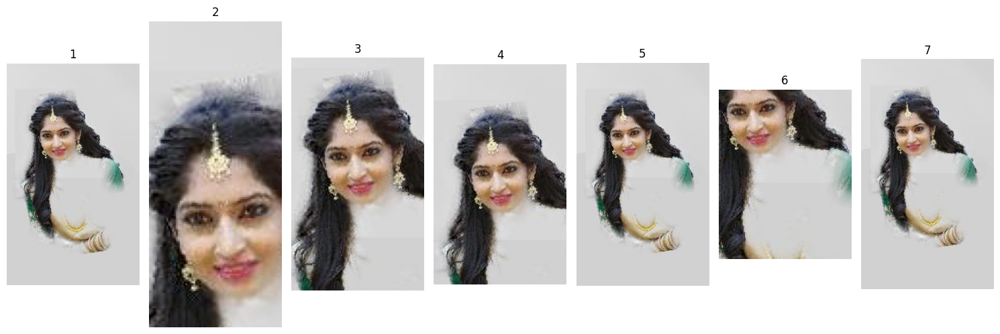

['hair', 'cap', 'face', 'head', 'face', 'neck', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 28.jpg


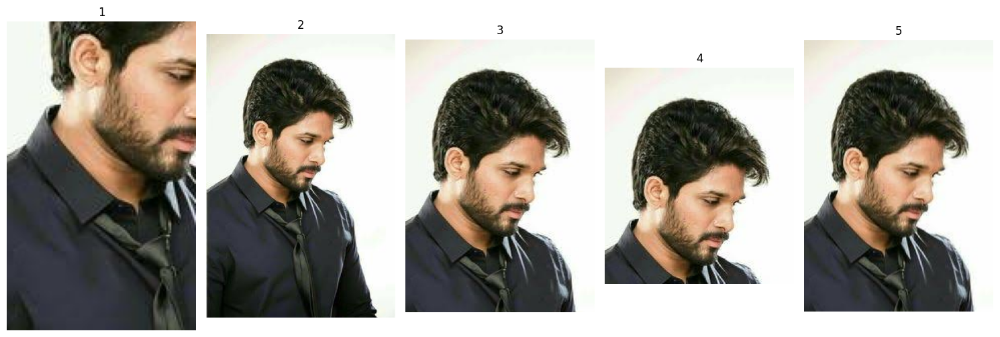

['neck', 'face', 'face', 'hair', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 29.jpg


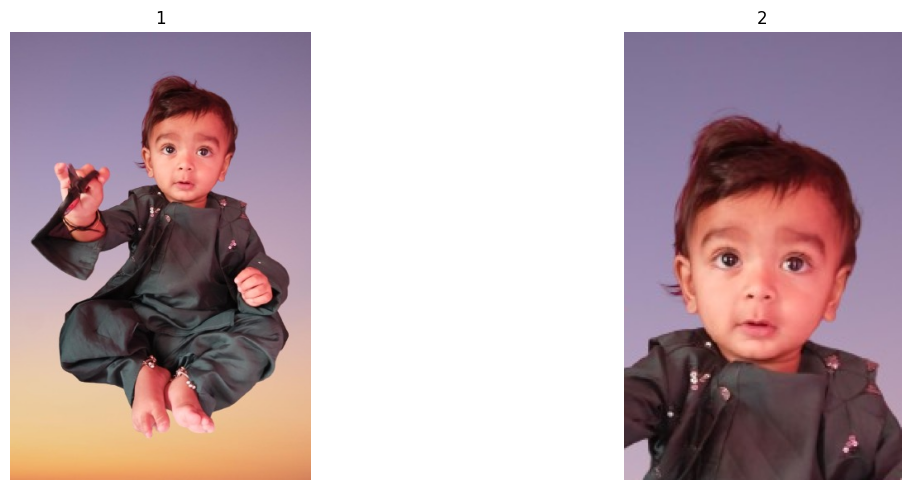

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 30.jpg


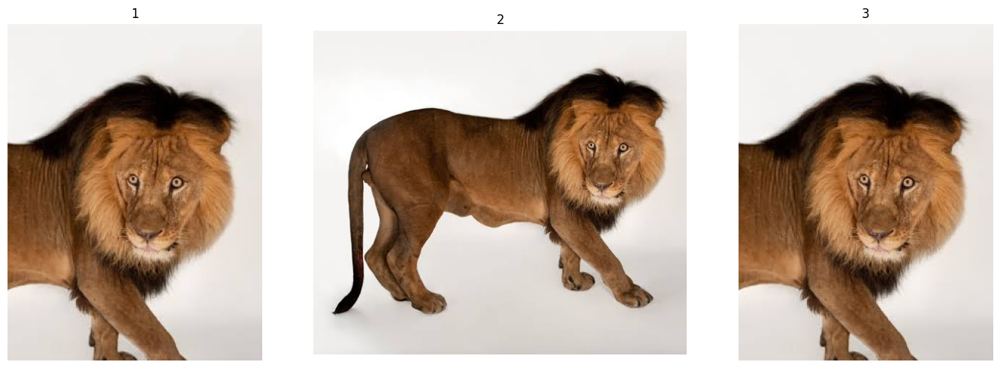

['head', 'face', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 31.jpg


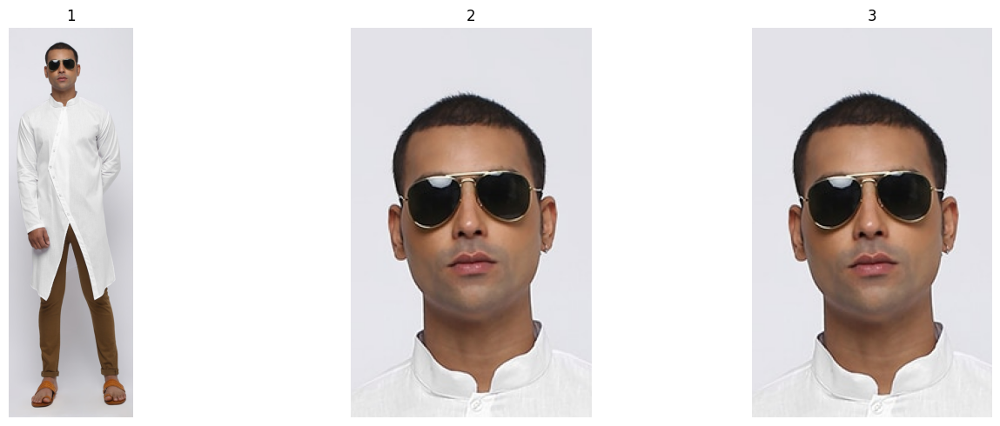

['face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

	32.jpg: Try Another Image 
 ____________________________________________________________________________________________________ 

Image: 33.jpg


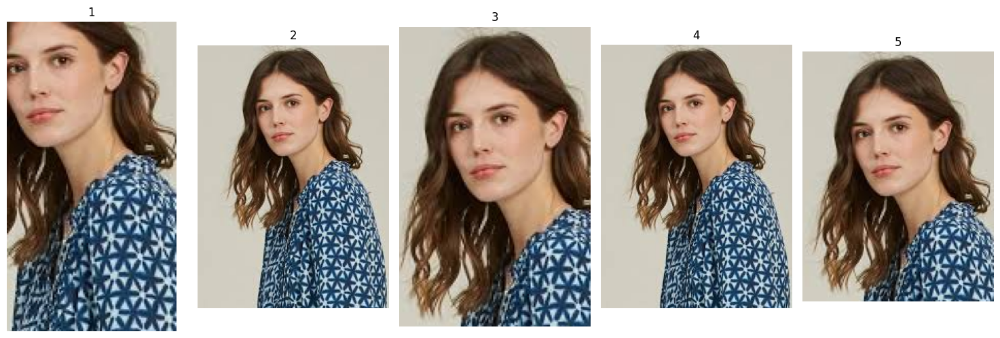

['neck', 'hair', 'face', 'head', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 34.jpg


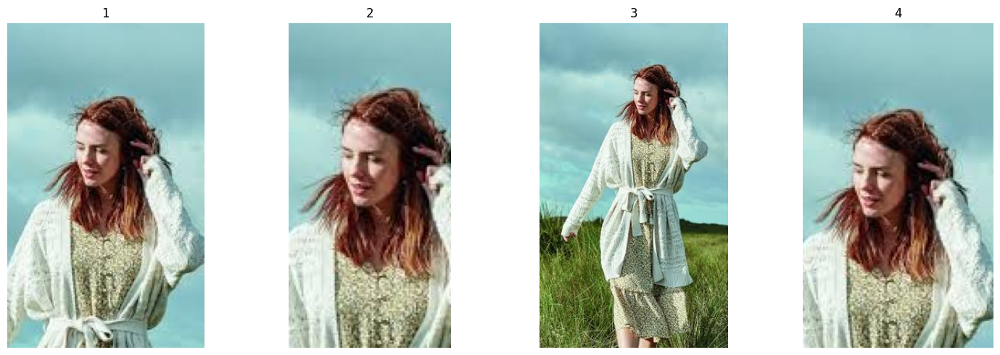

['hair', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 35.jpg


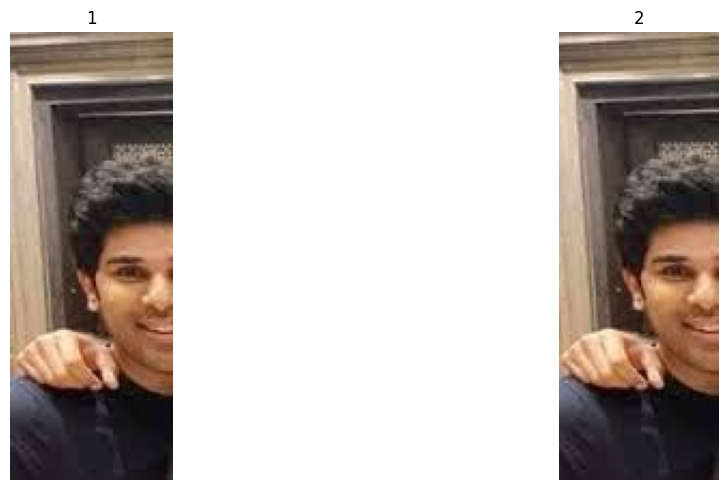

['face', 'face'] 
 ____________________________________________________________________________________________________ 

	36.jpg: Try Another Image 
 ____________________________________________________________________________________________________ 

Image: 37.jpg


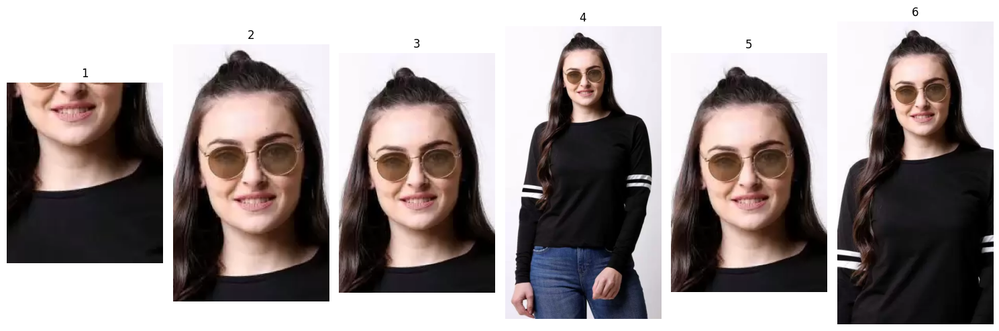

['neck', 'face', 'face', 'face', 'head', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 38.jpg


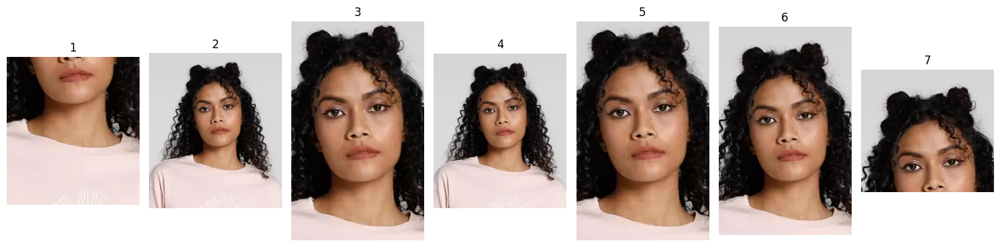

['neck', 'hair', 'face', 'head', 'head', 'head', 'cap'] 
 ____________________________________________________________________________________________________ 

Image: 39.jpg


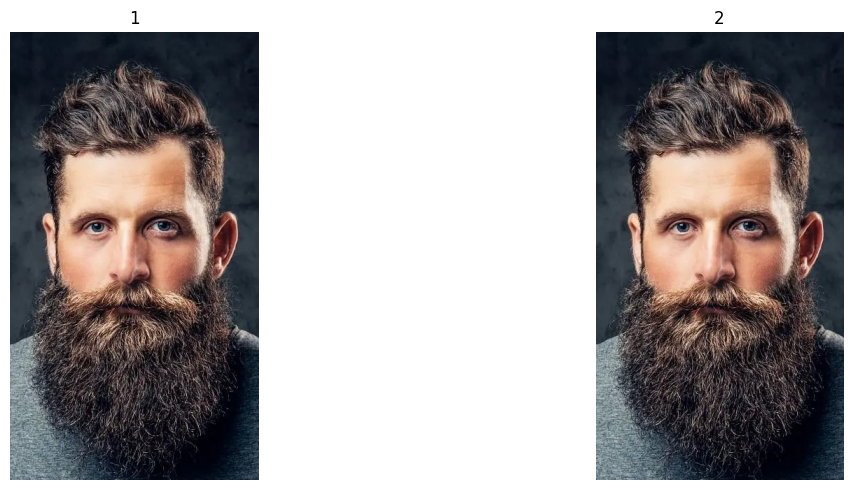

['face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 40.jpg


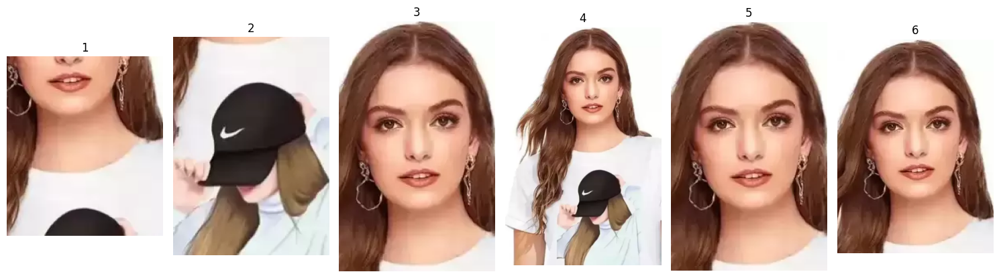

['neck', 'cap', 'face', 'hair', 'head', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 41.jpg


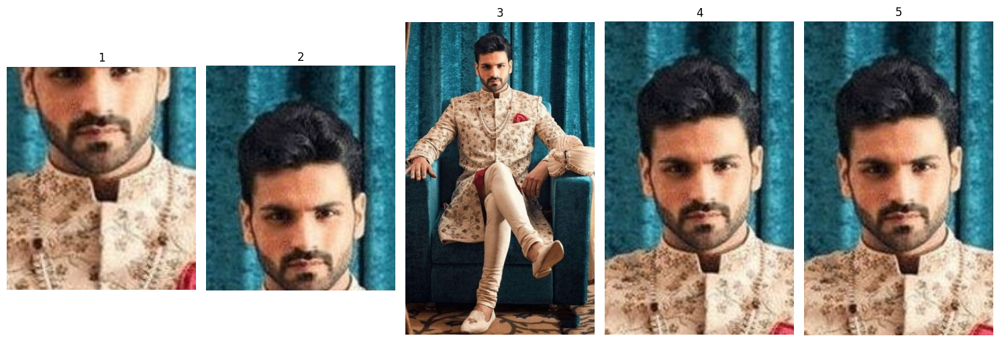

['neck', 'hair', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 42.jpg


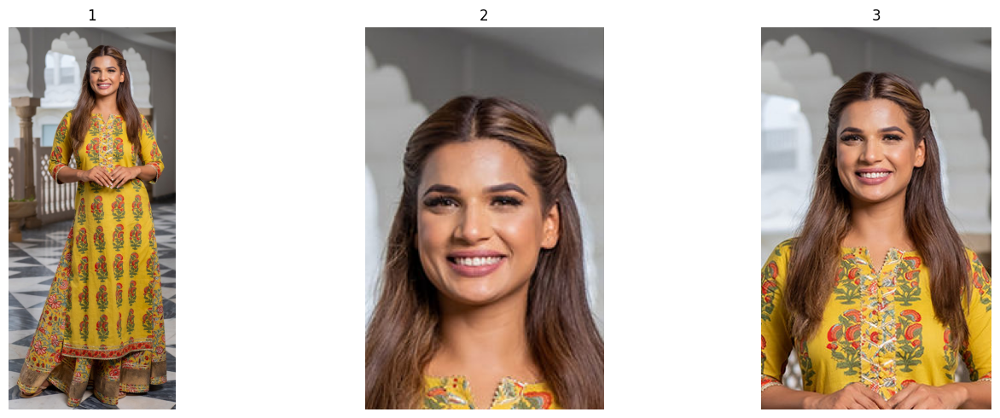

['face', 'head', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 43.jpg


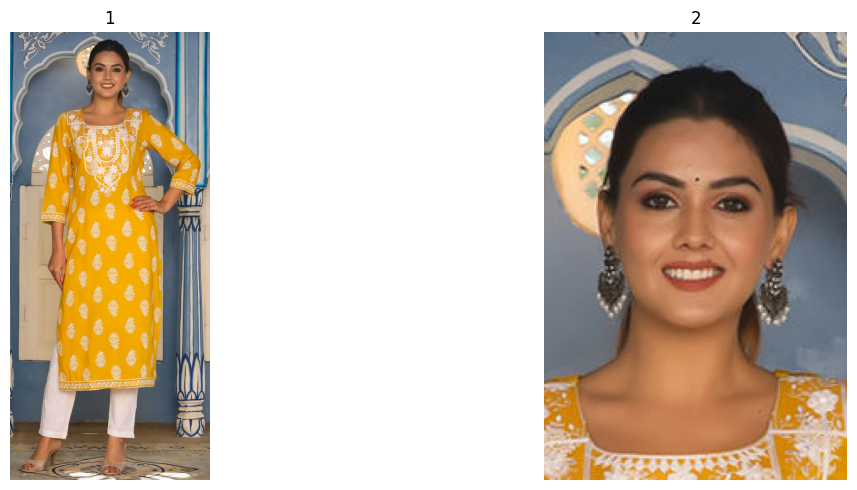

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 44.jpg


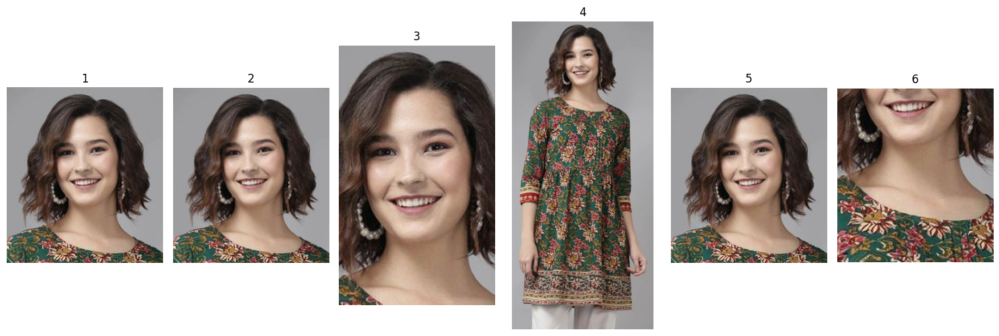

['face', 'hair', 'face', 'face', 'head', 'neck'] 
 ____________________________________________________________________________________________________ 

Image: 45.jpg


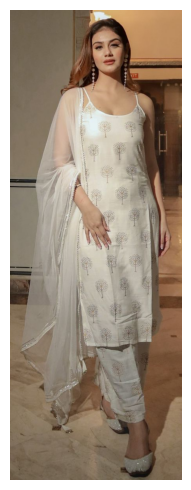

['face'] 
 ____________________________________________________________________________________________________ 

Image: 46.jpg


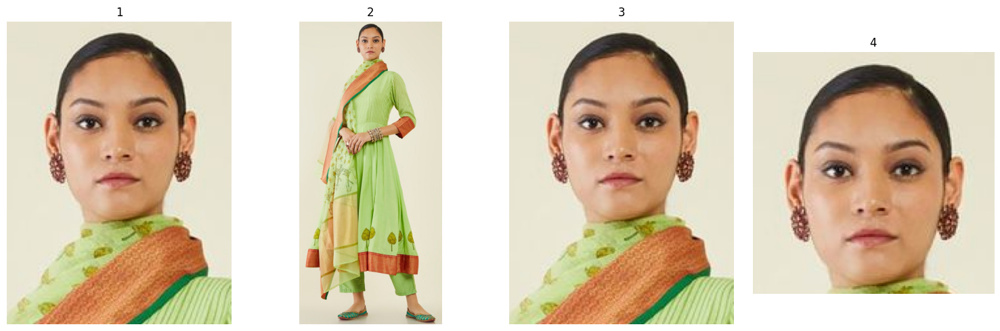

['face', 'face', 'head', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 47.jpg


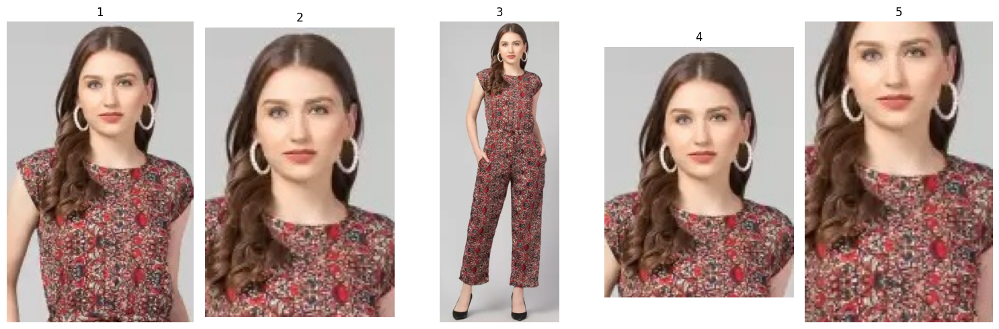

['hair', 'face', 'face', 'head', 'neck'] 
 ____________________________________________________________________________________________________ 

Image: 48.jpg


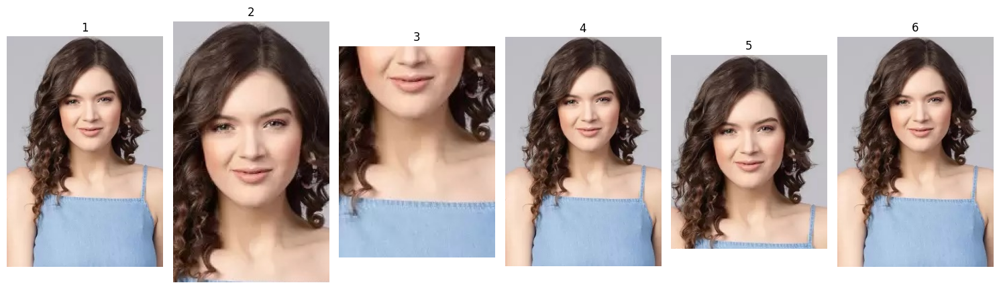

['hair', 'face', 'neck', 'head', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 49.jpg


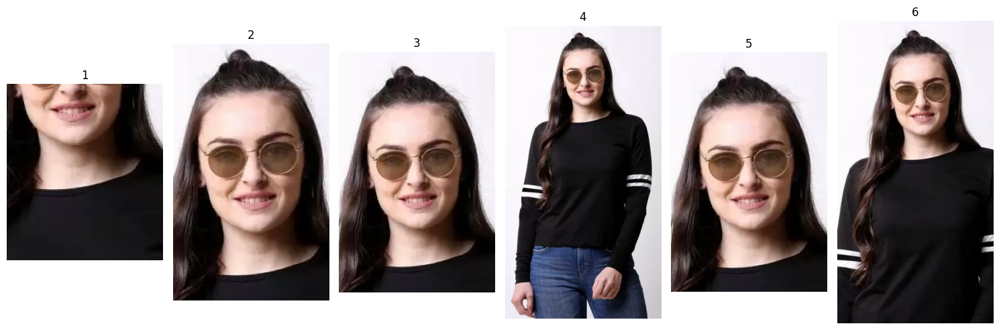

['neck', 'face', 'face', 'face', 'head', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 50.jpg


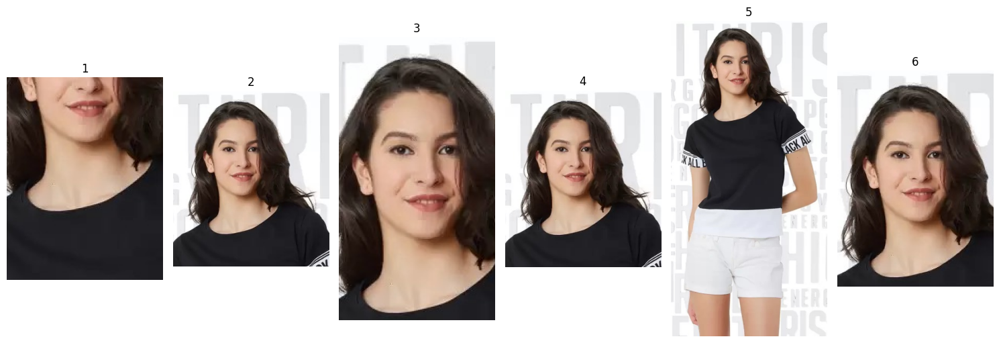

['neck', 'hair', 'face', 'head', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 51.jpg


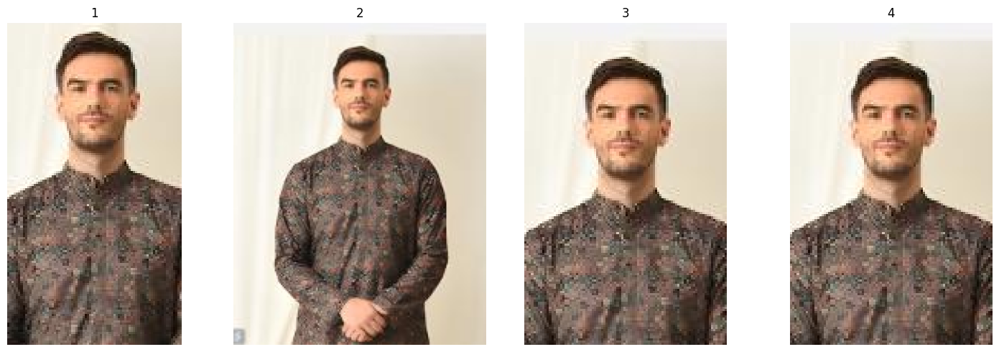

['neck', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 52.jpg


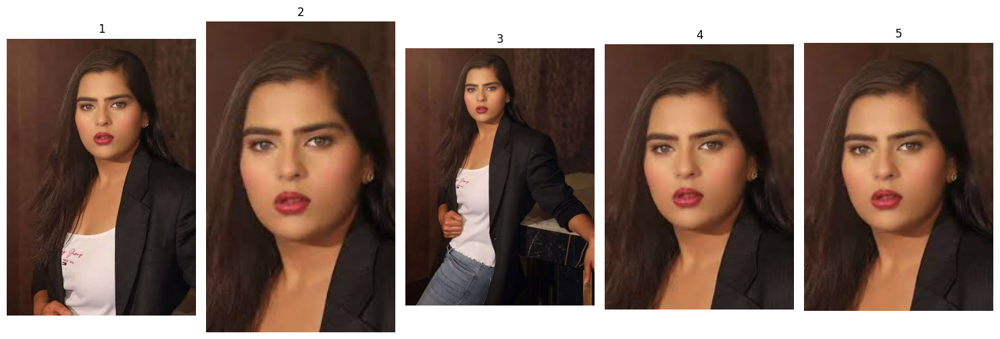

['hair', 'face', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 53.jpg


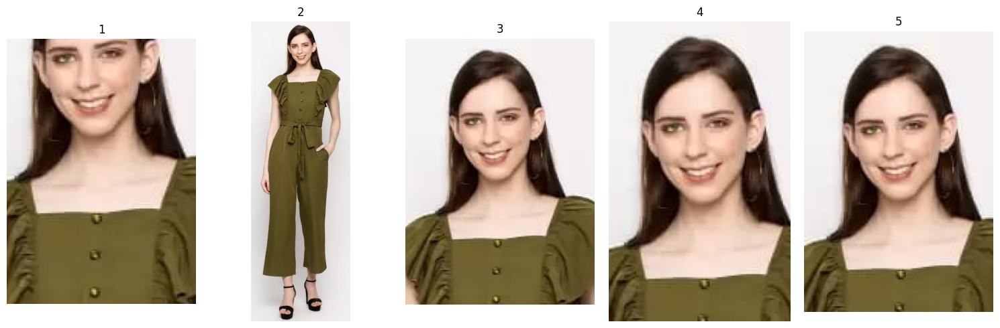

['neck', 'face', 'hair', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 54.jpg


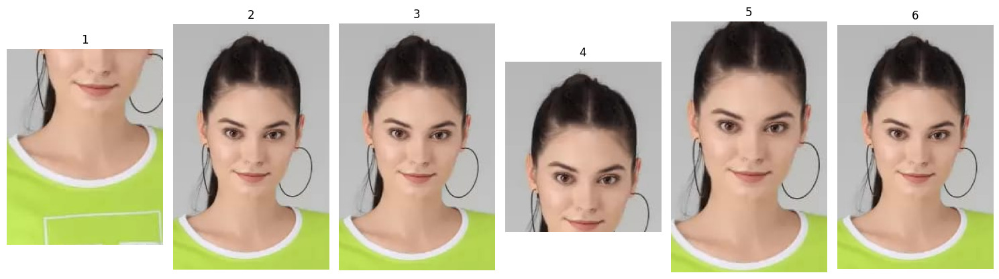

['neck', 'face', 'hair', 'hair', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 55.jpg


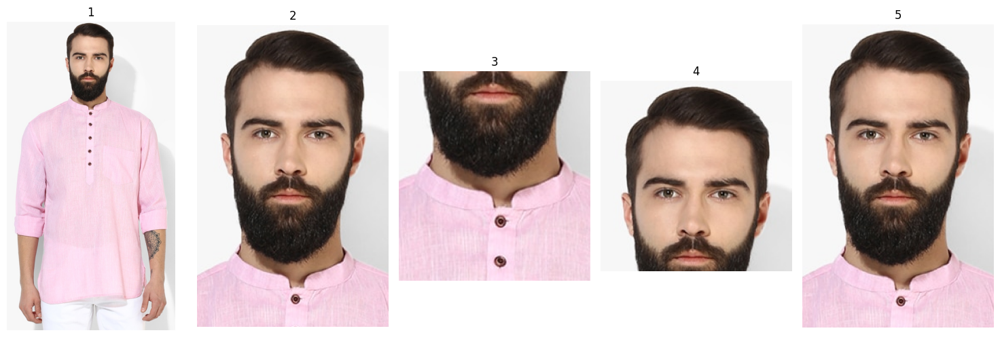

['face', 'face', 'neck', 'hair', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 56.jpg


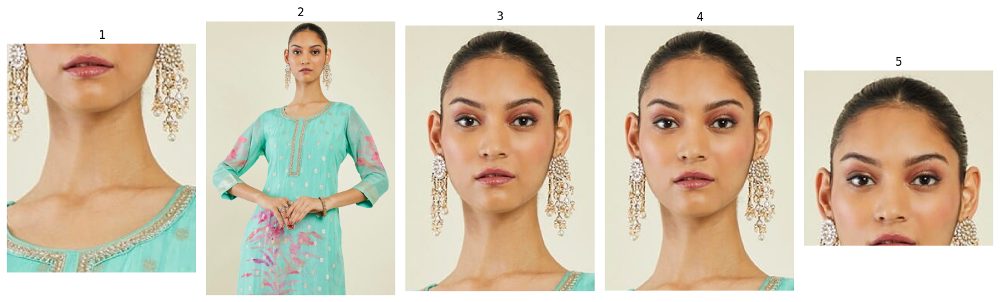

['neck', 'face', 'face', 'head', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 57.jpg


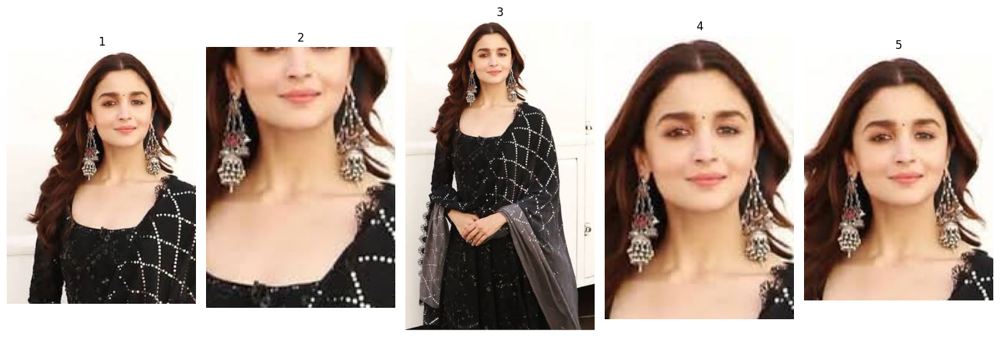

['hair', 'neck', 'face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 58.jpg


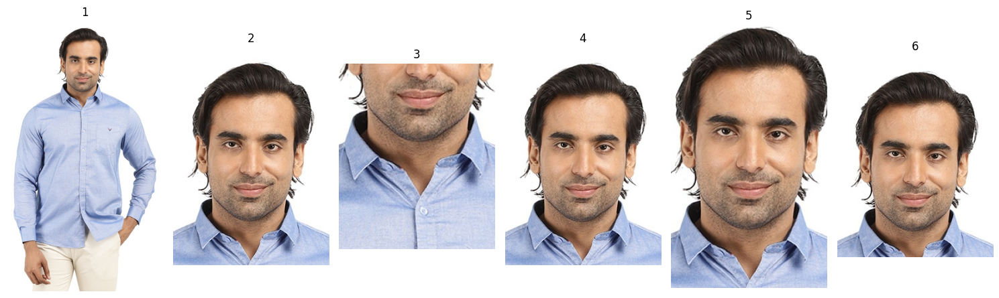

['face', 'face', 'neck', 'head', 'face', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 59.jpg


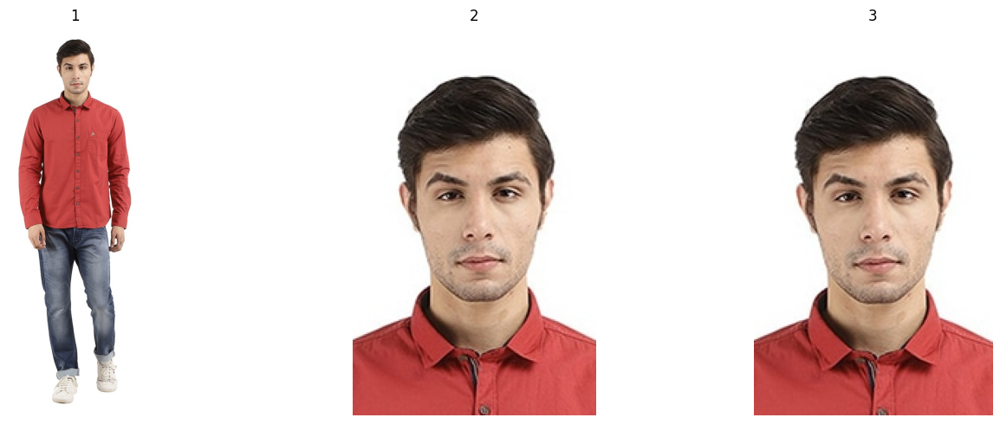

['face', 'face', 'head'] 
 ____________________________________________________________________________________________________ 

Image: 60.jpg


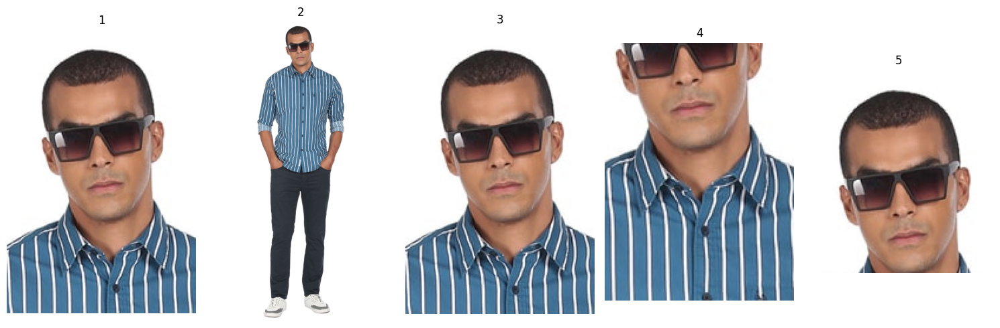

['face', 'face', 'head', 'neck', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 61.jpg


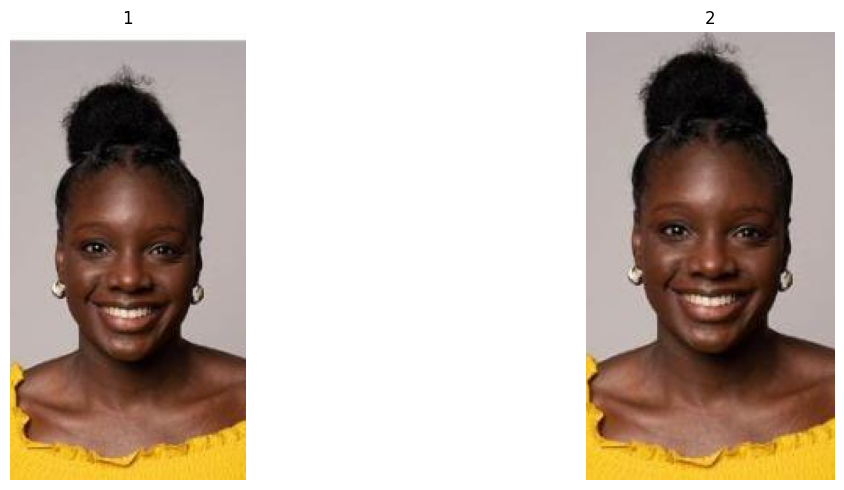

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 62.jpg


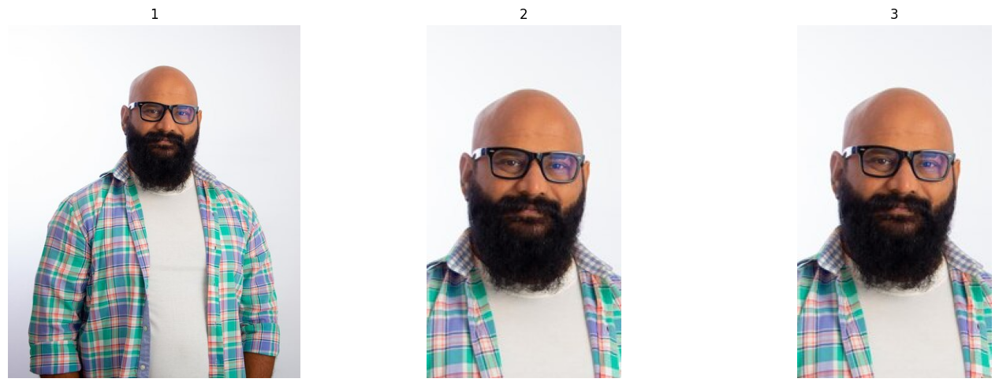

['face', 'head', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 63.jpg


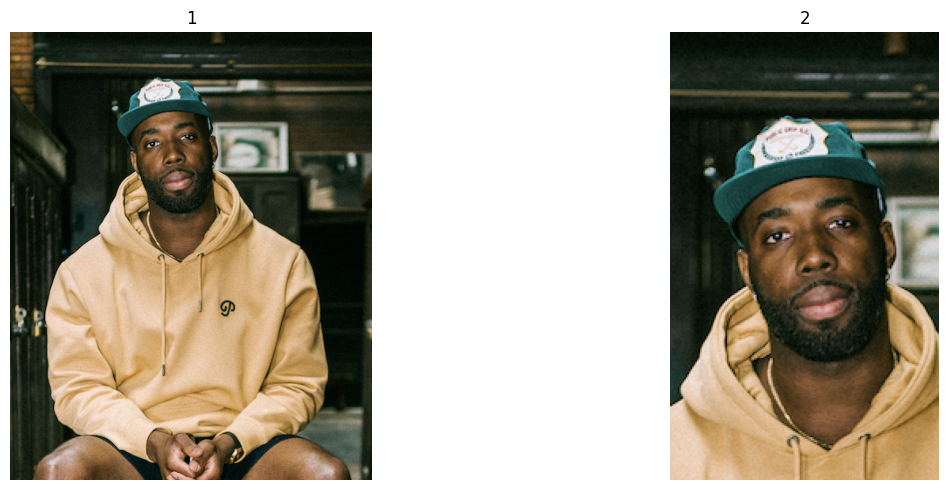

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 64.jpg


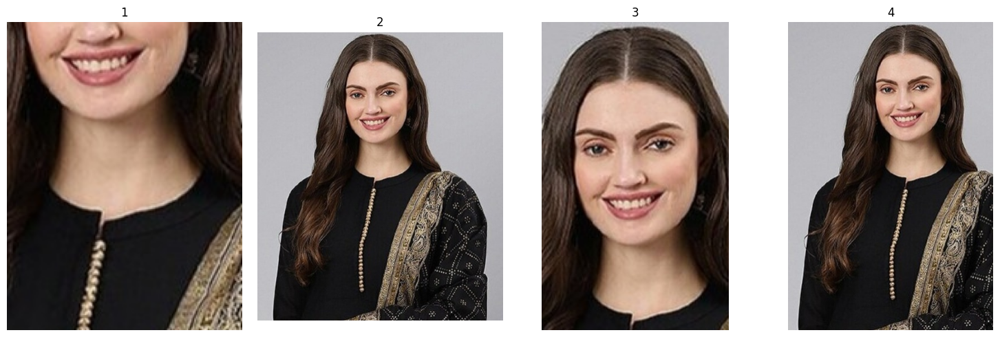

['neck', 'face', 'face', 'hair'] 
 ____________________________________________________________________________________________________ 

Image: 65.jpg


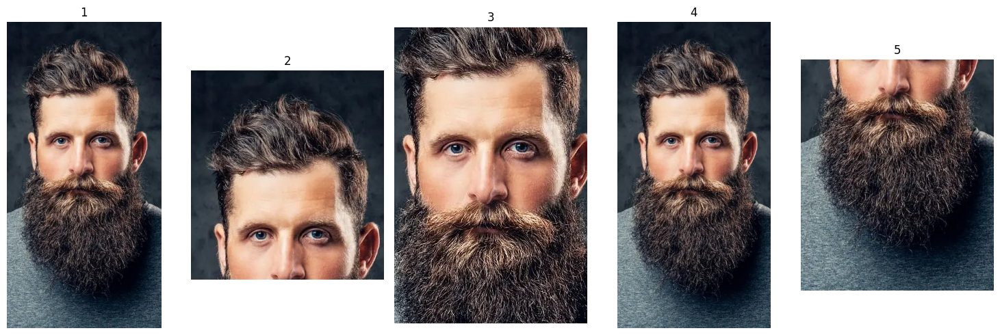

['face', 'hair', 'face', 'head', 'neck'] 
 ____________________________________________________________________________________________________ 

Image: 66.jpg


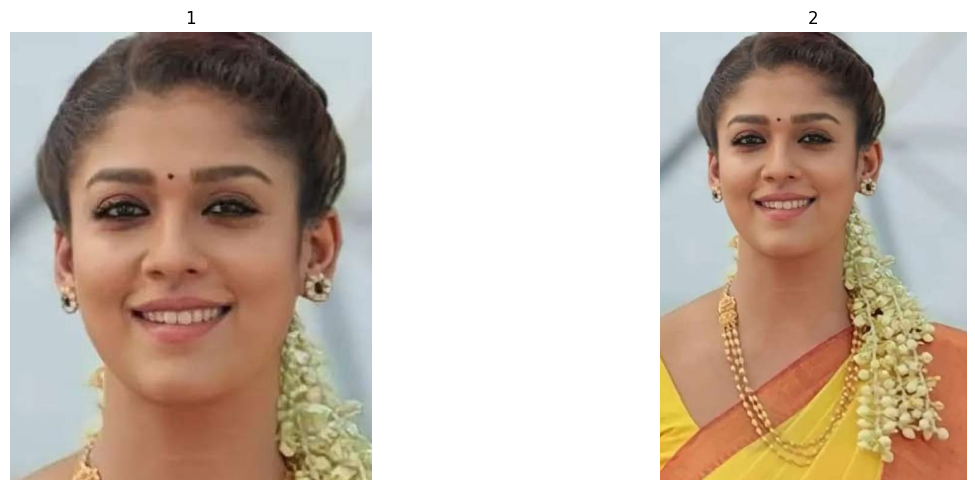

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 67.jpg


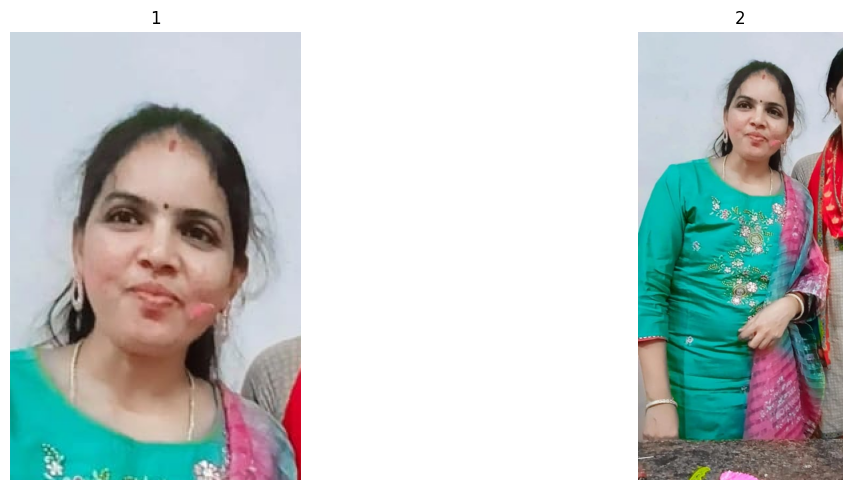

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 68.jpg


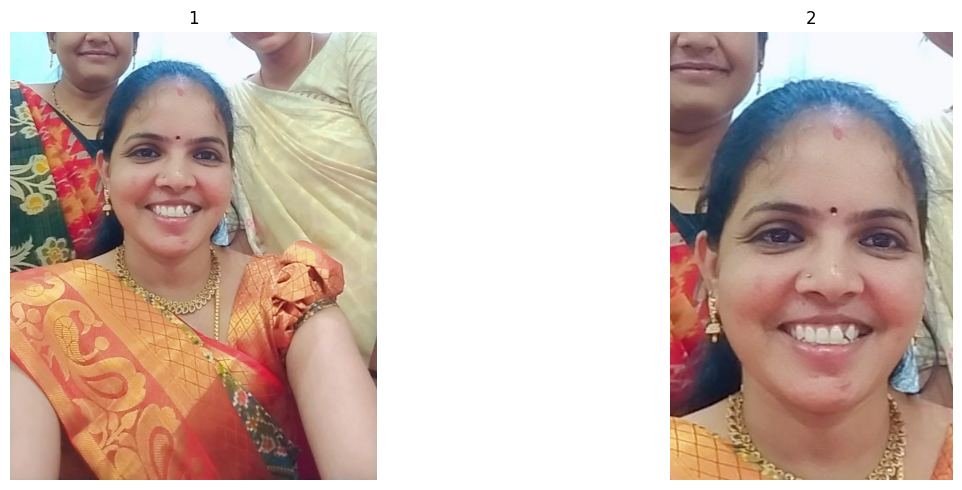

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 69.jpg


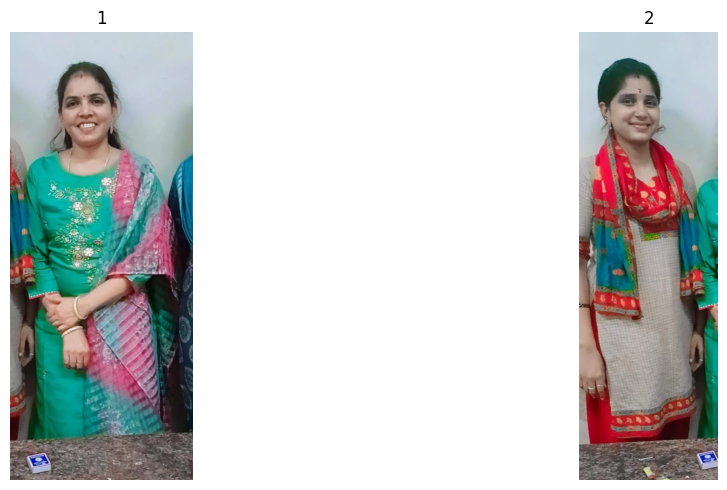

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 70.jpg


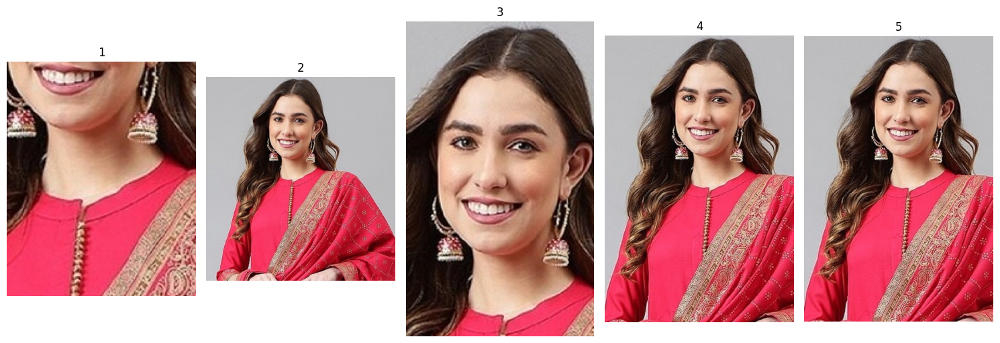

['neck', 'face', 'face', 'hair', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 71.jpg


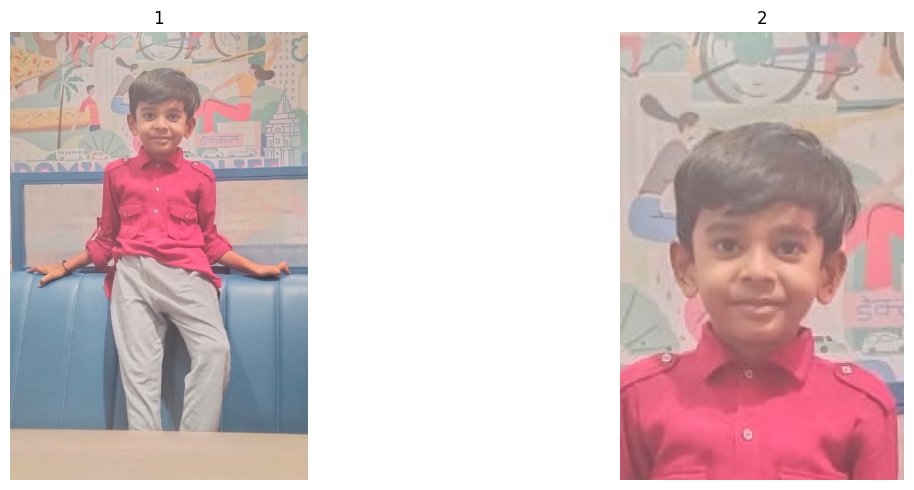

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 72.jpg


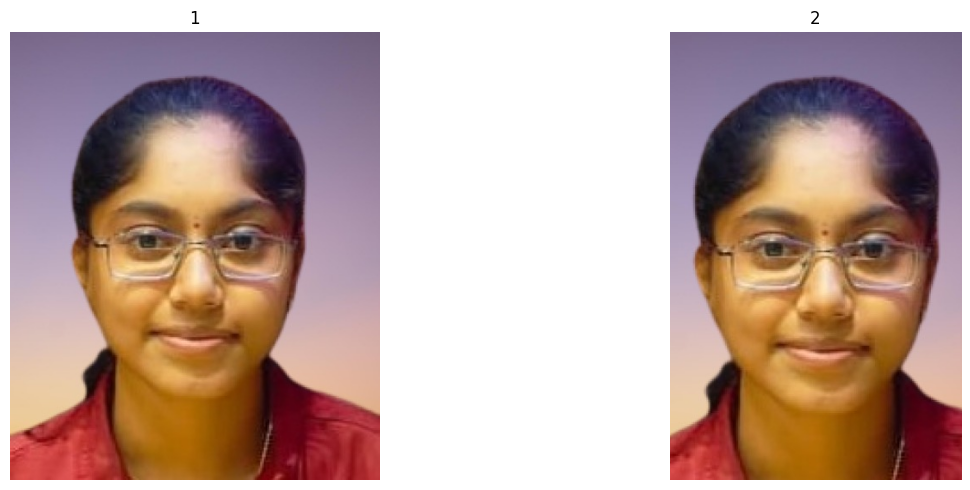

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 73.jpg


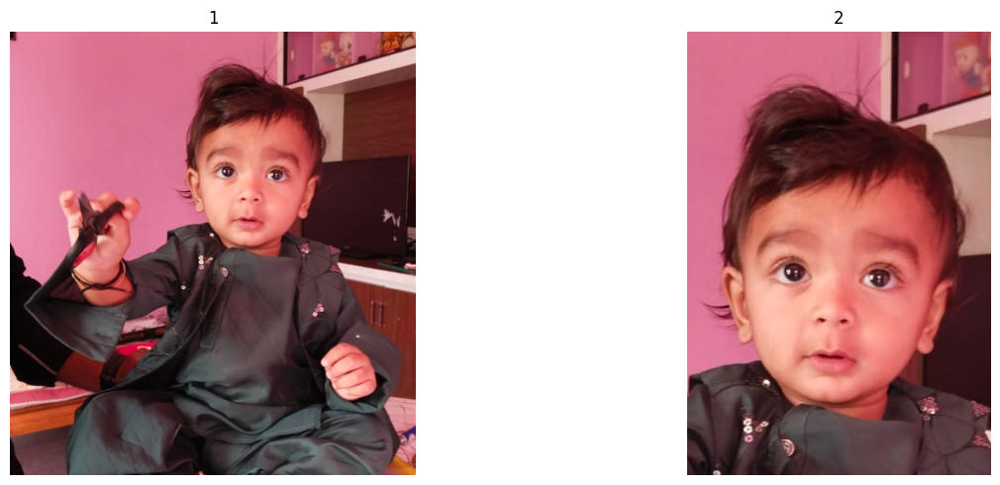

['face', 'face'] 
 ____________________________________________________________________________________________________ 

Image: 74.jpg


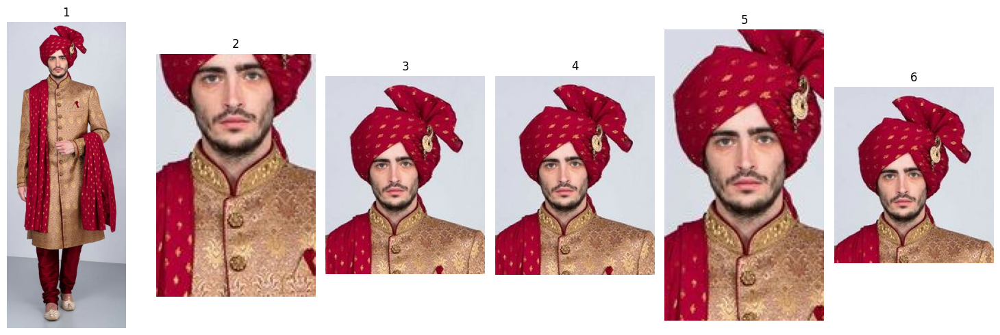

['face', 'neck', 'face', 'head', 'face', 'cap'] 
 ____________________________________________________________________________________________________ 

Image: 75.jpg


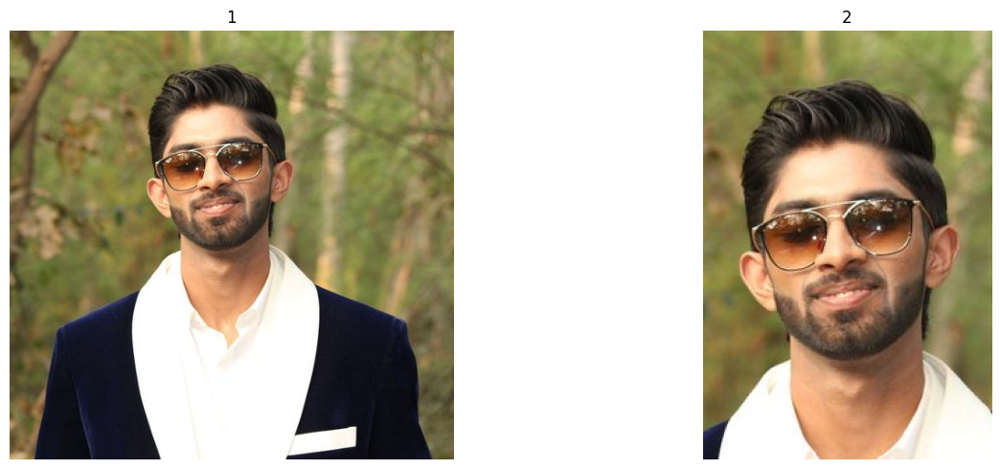

['face', 'face'] 
 ____________________________________________________________________________________________________ 



In [8]:
for filename in sorted(os.listdir(input_folder)):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        input_img = os.path.join(input_folder, filename)

        image_pil = Image.open(input_img).convert("RGB")
        combined_mask, found = Segment(model, image_pil, filename, output_folder)

        if combined_mask is not None:
            display_cropped_images(combined_mask)

        print(found, '\n', '_'*100, '\n')